# Tree Ring Signal On Spotgrid Measurements

Author: Johnny Esteves, University Of Michigan

## Description: 
Here we compute the tree ring signal from the spotgrid measurements. In particular, we look at astrometric shift, psf-size, shear and flux of the spots.

In [1]:
cd ..

/Users/jesteves/Documents/GitHub/lsst-treeRing


In [2]:
%reset -f
%matplotlib inline
%load_ext autoreload
%autoreload 2

import numpy as np

import matplotlib.pyplot as plt
plt.rc('image', interpolation='bicubic', origin='lower', cmap = 'viridis')
plt.rcParams["axes.formatter.useoffset"] = False
plt.rcParams['figure.figsize'] = [14.0, 10.0]
plt.rcParams['font.size'] = 16
rcParams = plt.rcParams.copy()

import matplotlib
matplotlib.rcParams['mathtext.fontset'] = 'stix'
matplotlib.rcParams['font.family'] = 'STIXGeneral'

# Load Data

Retrieve the output measurements from the spotgrid detector code, ```mixcoatl```.


<b> Updates since raft9 data </b>:

<li> correction for shaking on the z-direction of the xy-motor plataform </li>
<li> new distortion map imaging functionality </li>    
<li> compute ellipticities based on the second moments </li>
<li> transform the vectors to tree ring coordinates </li>

The respective functions are: <br>
```sensor.correct_shaking()``` <br>
```sensor.get_imaging_map()``` <br>
```sensor.compute_ellipticities()``` <br>
```sensor.transform_to_treeRing_coords()``` <br>


If the correction_shaking function is not applied the results are not correct.


# Tree Rings: Generate Signal Profiles

The ```tree_ring_helper``` script has a set of function to produce the tree ring signal. Also, you can find a set of visualization plots that helps to check the analysis. <br>

<b> Updates:  </b> <br> the main update is the tree ring center lookup table. Only with the sensor name the code retrieves the tree ring center and other info.

In [64]:
import tree_ring_helper as tr

keys = {
        'astrometric-shift':['r','Astrometric Shift [pixels]',1.],
        'flux-ratio':['abs','Flux-Ratio', 100.],
        'psf-size':['abs','PSF-Size: $I_{xx}+I_{yy}$',100.],
        'ellipticity':['abs_diff','Shear: $\\sqrt{e_1^2+e_2^2}$',100.]
       }

In [ ]:
## Generate Tree Ring Profiles
# treeRings = {}
for variable in ['ellipticity']:
    print('Variable: %s'%variable)
    component = keys[variable][0]
    ylabel = keys[variable][1]
    strech = keys[variable][2]
    rings = []
    
    for sensor in sensors:
        print('Sensor Bay: %s'%(sensor.sensorbay))
        ring = tr.tree_ring_tools(sensor)
        ring.make_image(variable, component, fradius=None)
        
        ring.apply_strech(strech)
        ring.apply_high_freq_filter(use_zero=False)
        ring.apply_gaussian_filter(downscale=4)
        ring.apply_mask()

        ring.make_polar_transformation(theta_cut=[100, 250])
        ring.compute_signal()
        ring.make_profile(ring.diff2,step=1)
        ring.save_profile(variable)
        rings.append(ring)
        print('\n')
    treeRings[variable] = rings

Variable: ellipticity
Sensor Bay: R03_S12
Welcome to Tree Ring Tools


/usr/local/anaconda/lib/python3.8/site-packages/skimage/measure/block.py:86: RuntimeWarning: Mean of empty slice
  return func(blocked, axis=tuple(range(image.ndim, blocked.ndim)),


saving: profiles/ellipticity_ITL_R03_S12.npy


Sensor Bay: R10_S11
Welcome to Tree Ring Tools


/usr/local/anaconda/lib/python3.8/site-packages/skimage/measure/block.py:86: RuntimeWarning: Mean of empty slice
  return func(blocked, axis=tuple(range(image.ndim, blocked.ndim)),


saving: profiles/ellipticity_ITL_R10_S11.npy


Sensor Bay: R24_S11
Welcome to Tree Ring Tools


/usr/local/anaconda/lib/python3.8/site-packages/skimage/measure/block.py:86: RuntimeWarning: Mean of empty slice
  return func(blocked, axis=tuple(range(image.ndim, blocked.ndim)),


saving: profiles/ellipticity_E2V_R24_S11.npy


Sensor Bay: R32_S01
Welcome to Tree Ring Tools


/usr/local/anaconda/lib/python3.8/site-packages/skimage/measure/block.py:86: RuntimeWarning: Mean of empty slice
  return func(blocked, axis=tuple(range(image.ndim, blocked.ndim)),


saving: profiles/ellipticity_E2V_R32_S01.npy


Sensor Bay: R22_S11
Welcome to Tree Ring Tools


/usr/local/anaconda/lib/python3.8/site-packages/skimage/measure/block.py:86: RuntimeWarning: Mean of empty slice
  return func(blocked, axis=tuple(range(image.ndim, blocked.ndim)),


saving: profiles/ellipticity_E2V_R22_S11.npy


Sensor Bay: R02_S02
Welcome to Tree Ring Tools


In [ ]:
# import pickle

# pickle.dump(treeRings, open("tempTree.p", "wb"))  # save it into a file named save.p
# # temp_treeRing = pickle.load(open("tempTree.p", "rb"))

# Tree Rings: Visualization

## Distortion Maps

In [66]:
import datetime
from matplotlib.backends.backend_pdf import PdfPages

def make_plot_array(ix):
    fig, axes = plt.subplots(2, 2, figsize=(14, 12))
    axes = axes.flatten()

    for i, variable in enumerate(['flux-ratio','astrometric-shift','psf-size','ellipticity']):
        rings = treeRings[variable]
        ring = rings[ix]
        if variable=='flux-ratio':
            im = imshow(ring.img,axes[i],title=keys[variable][1],
                        levels=[-0.75,0.75],show_colorbar=True)
        else:
            im = imshow(ring.diff,axes[i],title=keys[variable][1],
                        levels=[ring.l1,ring.l2],show_colorbar=True)
        fig.colorbar(im, ax=axes[i], shrink=0.9)#.set_label(keys[variable][1])    
    
    fig.suptitle(ring.sensorbay)


In [67]:
def imshow(image,axes,title='',show_colorbar=False,levels=[-0.015,0.015]):
    im0 = axes.imshow(image,origin='lower',vmin=levels[0],vmax=levels[1], cmap='viridis')
    axes.set_xlabel('X position [pixels]', fontsize=15)
    axes.set_ylabel('Y position [pixels]', fontsize=15)
    axes.tick_params(axis='x', labelsize=12)
    axes.tick_params(axis='y', labelsize=12)
    axes.set_aspect('equal')
    axes.set_title(title)
    if show_colorbar: return im0

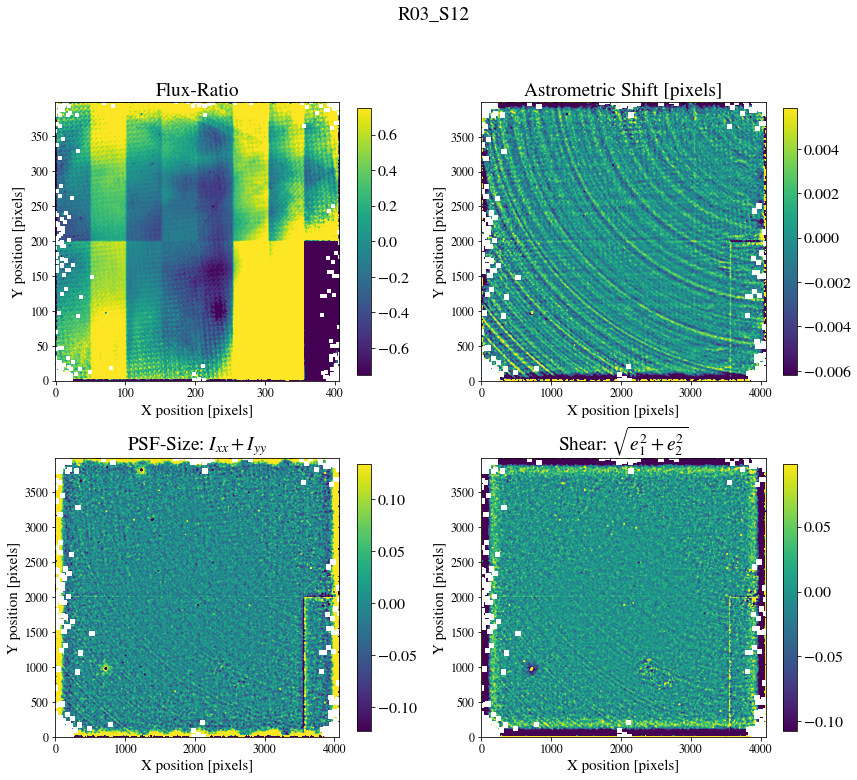

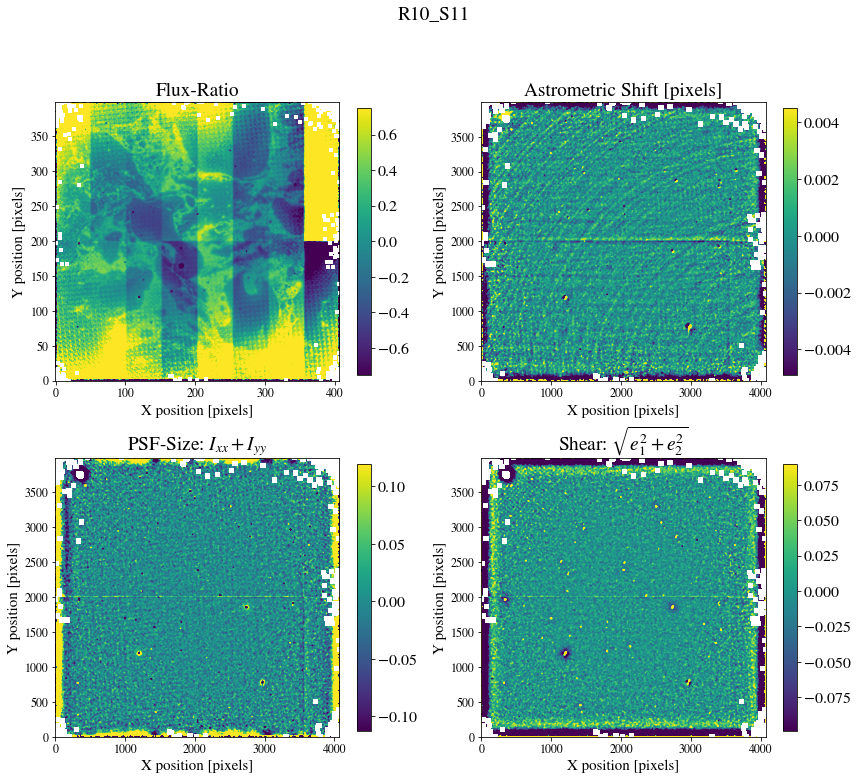

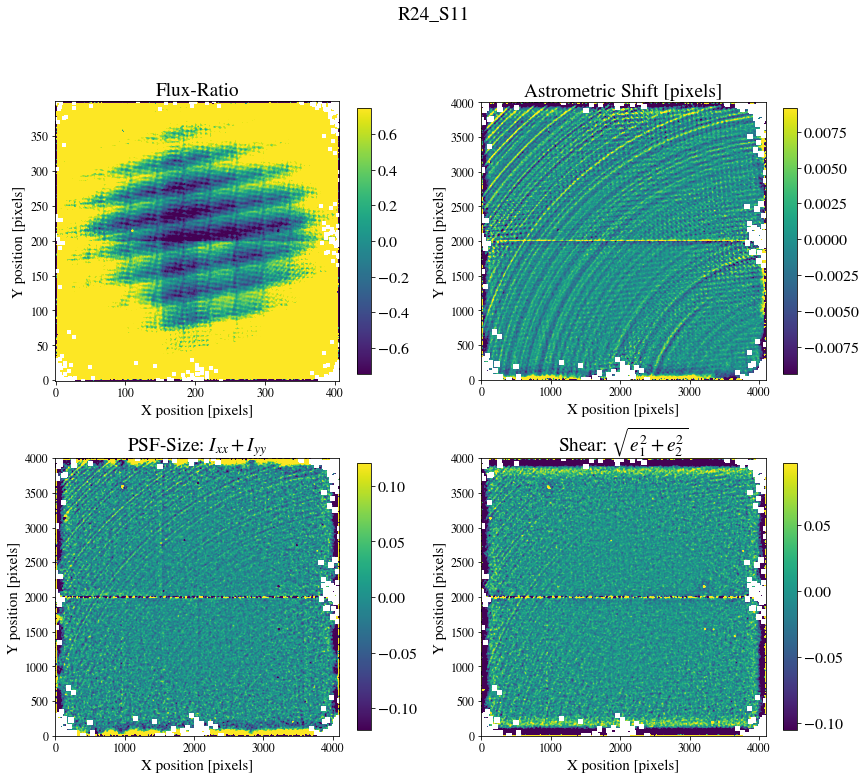

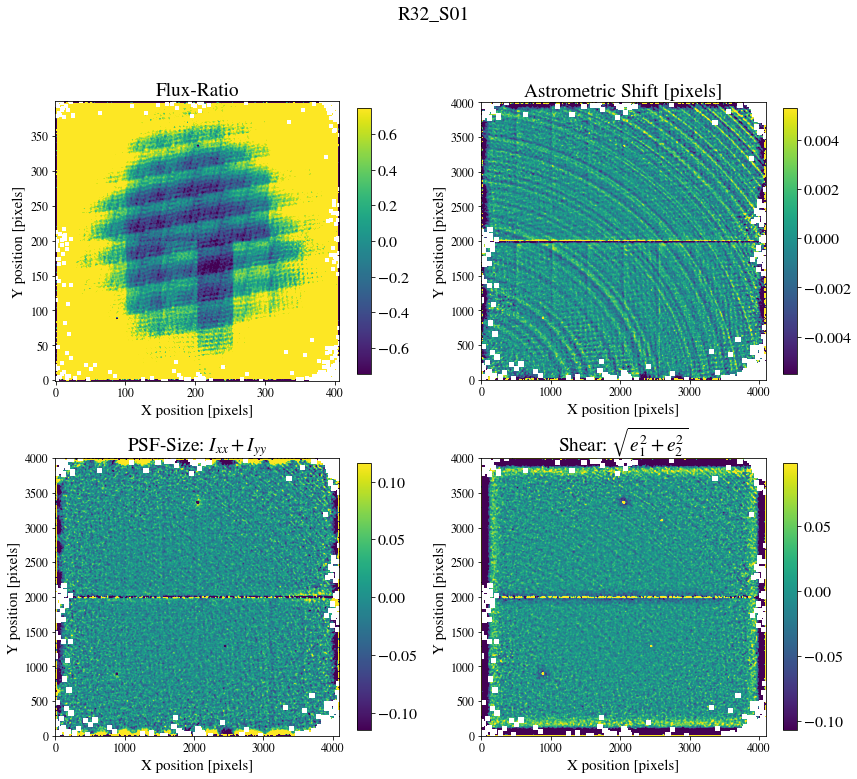

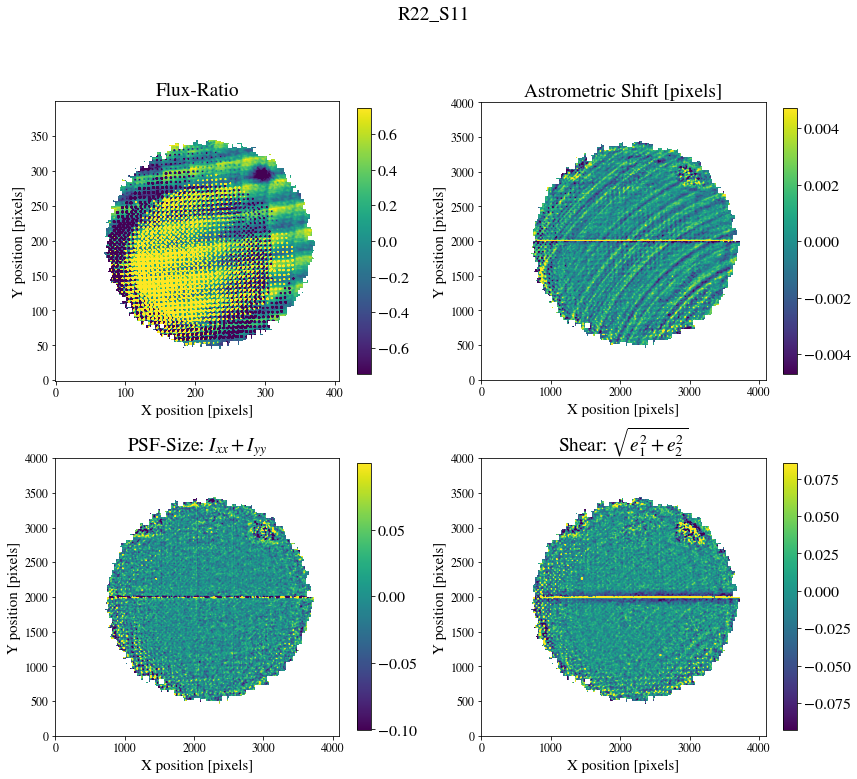

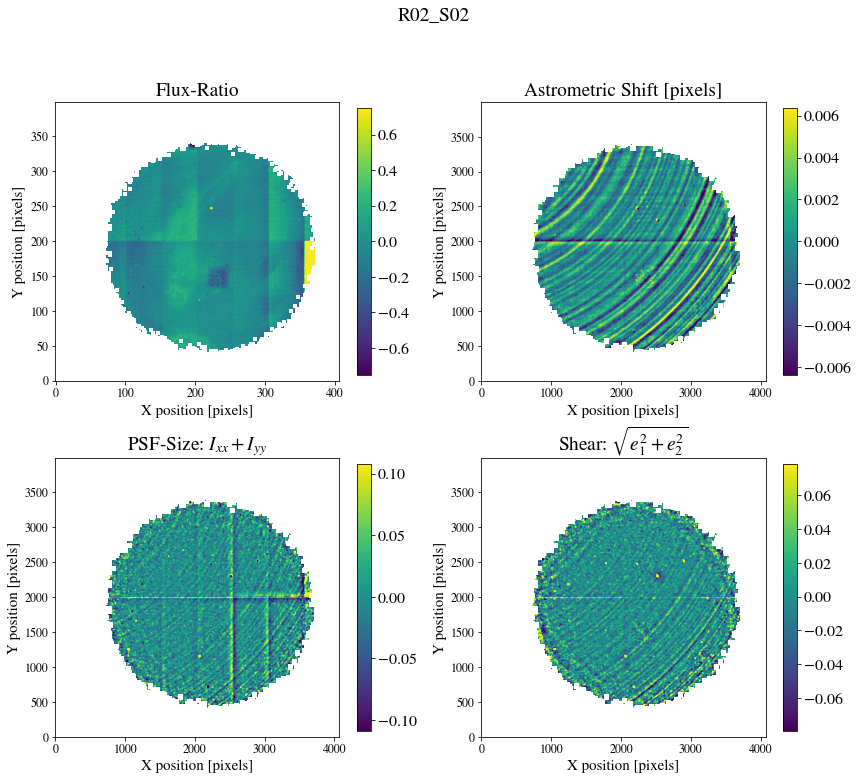

In [68]:
## plot square
with PdfPages('./figures/fig_distortionMap_array_collection.pdf') as pdf:
    for ix in range(len(rings)):
        make_plot_array(ix)
        pdf.savefig()

## Check Polar Transformation

In [ ]:
# Make Plots
variable = 'ellipticity'
component = keys[variable][0]
ylabel = keys[variable][1]
strech = keys[variable][2]

In [ ]:
import datetime

rings = treeRings[variable]
with PdfPages('./figures/fig_polarMap_%s_collection.pdf'%variable) as pdf:
    for ring in rings:
        ring.set_ylabel(ylabel)
        ring.plot_pannel_image_signal()
        plt.xlim(1000., 5000.)
        pdf.savefig()
        #plt.close()
        
    d = pdf.infodict()
    d['Title'] = 'Spot Grid Images - Tree Ring Analysis'
    d['Author'] = 'Johnny Esteves'
    d['CreationDate'] = datetime.datetime.today()
    


In [ ]:
# rings = treeRings[variable]
# ring = rings[-1]
# with PdfPages('./figures/fig_polarMap_%s_collection.pdf'%variable) as pdf:
#     for ring in rings:
#         ring.set_ylabel(ylabel)
#         ring.check_polar_transfomartion()
#         pdf.savefig()
#         #plt.close()
        
#     d = pdf.infodict()
#     d['Title'] = 'Spot Grid Images - Tree Ring Analysis'
#     d['Author'] = 'Johnny Esteves'
#     d['CreationDate'] = datetime.datetime.today()
    

## Astrometric Shift

In [49]:
# Make Plots
variable = 'astrometric-shift'
component = keys[variable][0]
ylabel = keys[variable][1]
strech = keys[variable][2]

/usr/local/anaconda/lib/python3.8/site-packages/skimage/measure/block.py:86: RuntimeWarning: Mean of empty slice
  return func(blocked, axis=tuple(range(image.ndim, blocked.ndim)),


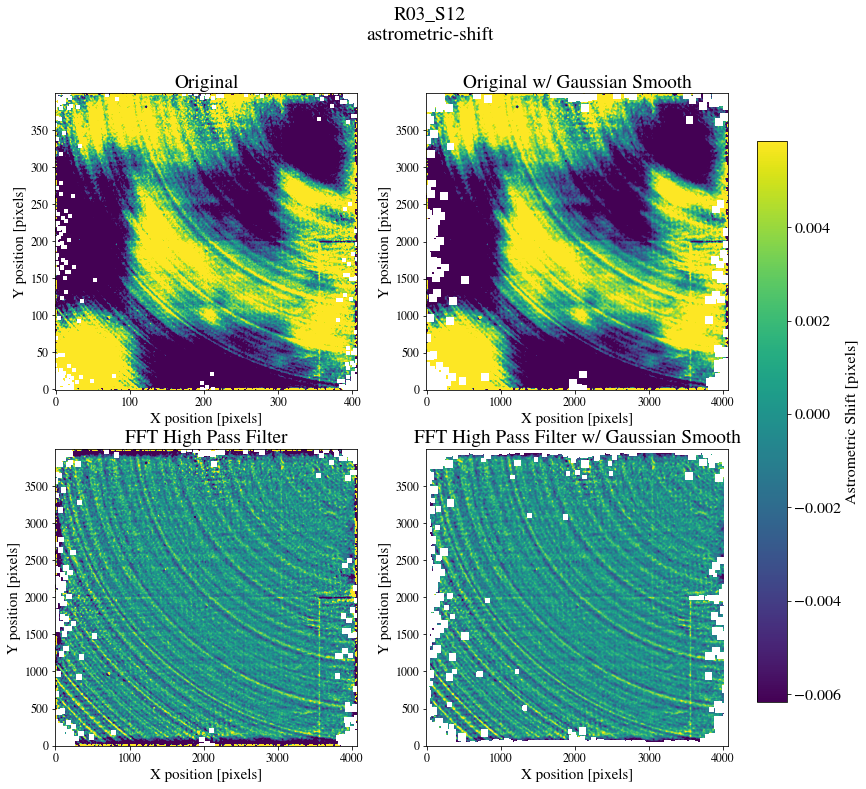

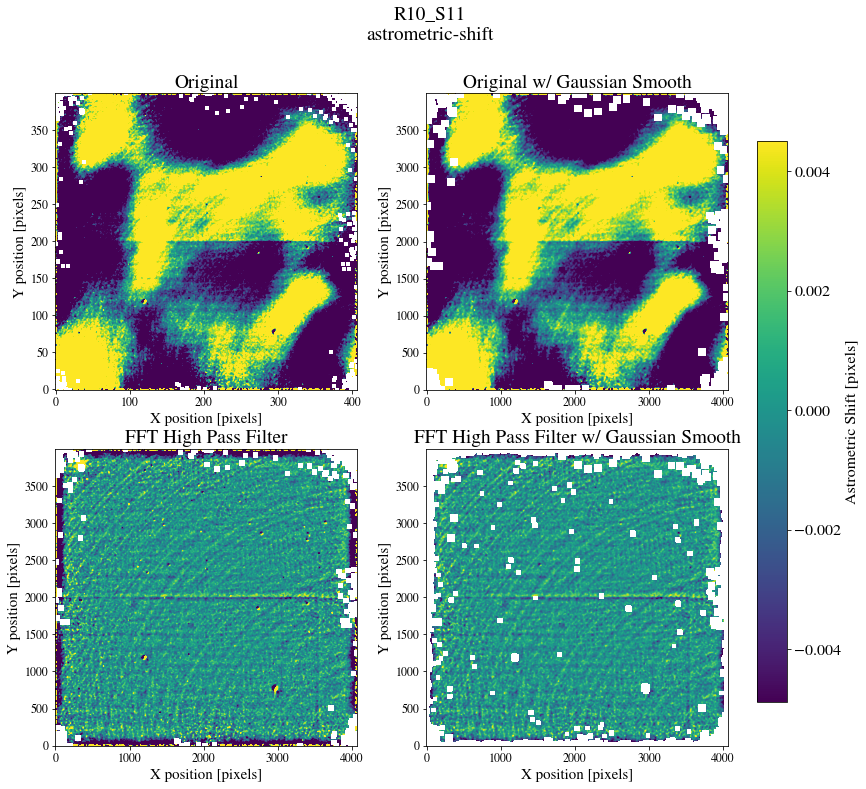

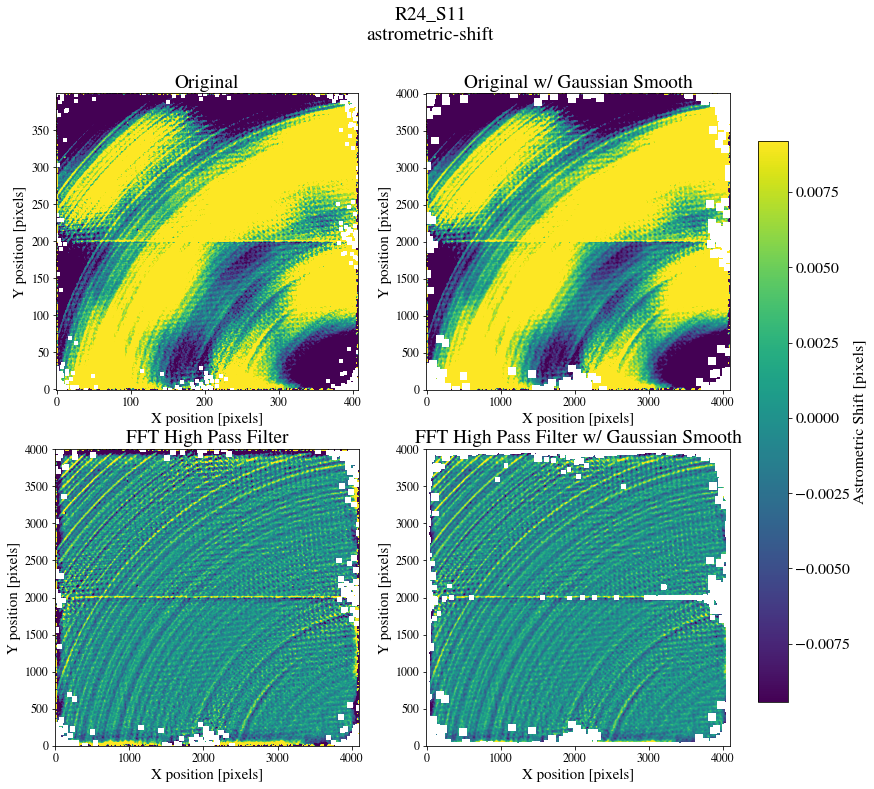

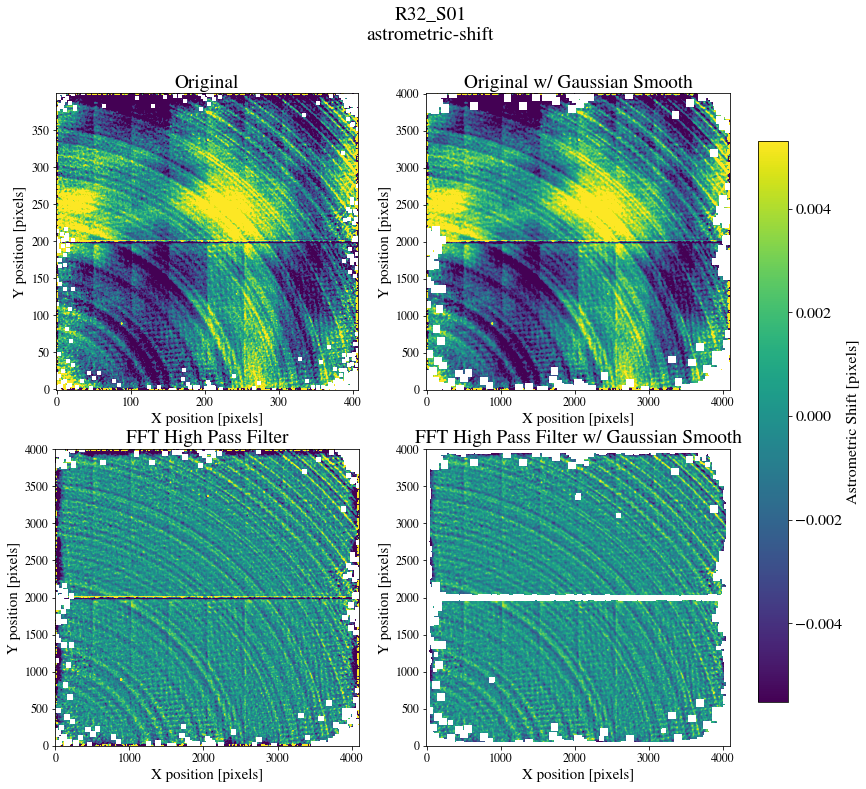

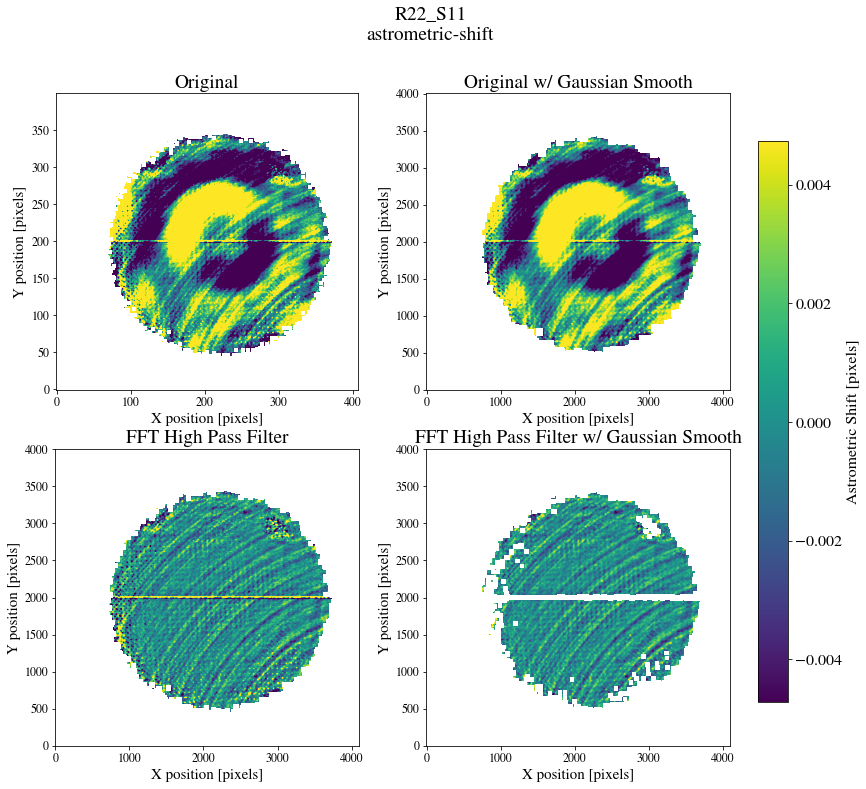

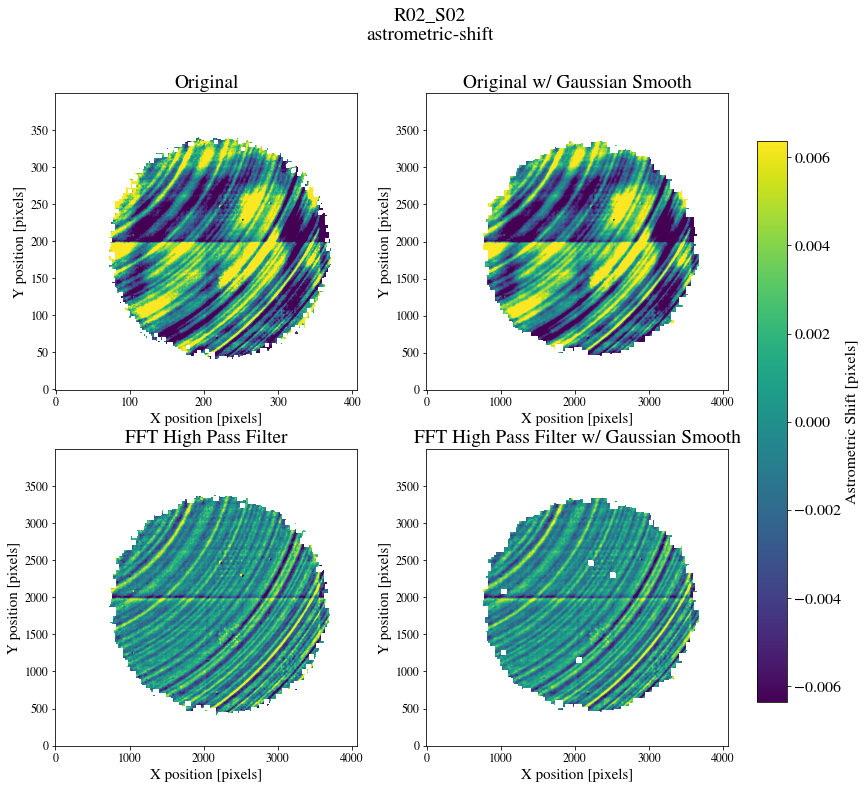

In [50]:
import datetime
import numpy as np
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib.pyplot as plt

rings = treeRings[variable]
with PdfPages('./figures/fig_distortionMap_%s_collection.pdf'%variable) as pdf:
    for ring in rings:
        ring.set_ylabel(ylabel)
        ring.variable = variable
        ring.apply_mask()
        ring.set_title()
        ring.display_images()
        pdf.savefig()
        #plt.close()
        
    d = pdf.infodict()
    d['Title'] = 'Spot Grid Images - Tree Ring Analysis'
    d['Author'] = 'Johnny Esteves'
    d['CreationDate'] = datetime.datetime.today()
    

## Psf-Size

In [51]:
# Make Plots
variable = 'psf-size'
component = keys[variable][0]
ylabel = keys[variable][1]
strech = keys[variable][2]

/usr/local/anaconda/lib/python3.8/site-packages/skimage/measure/block.py:86: RuntimeWarning: Mean of empty slice
  return func(blocked, axis=tuple(range(image.ndim, blocked.ndim)),


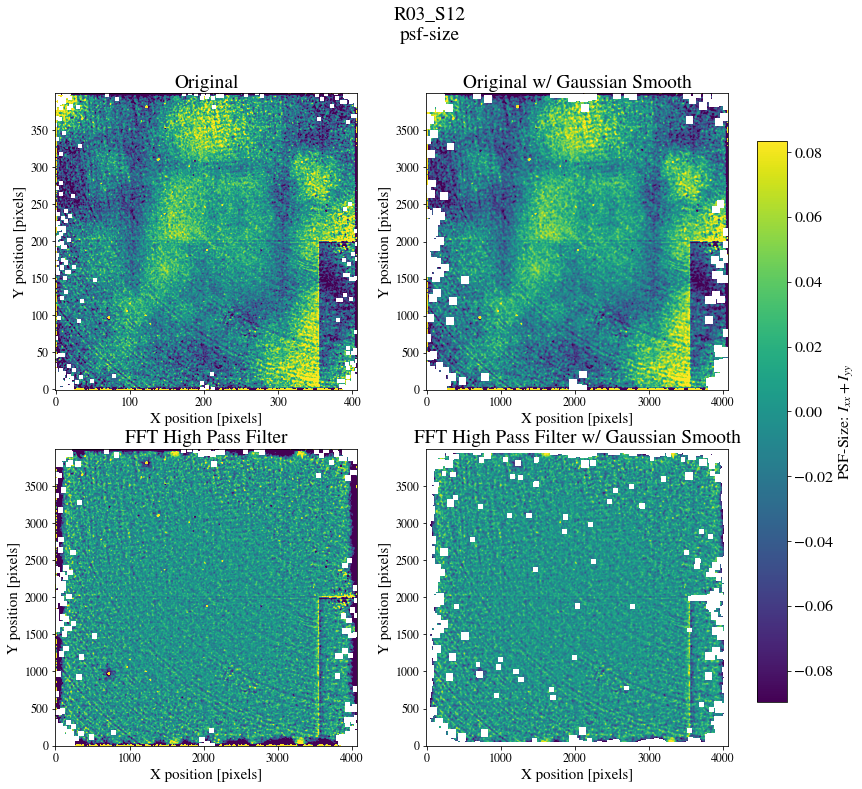

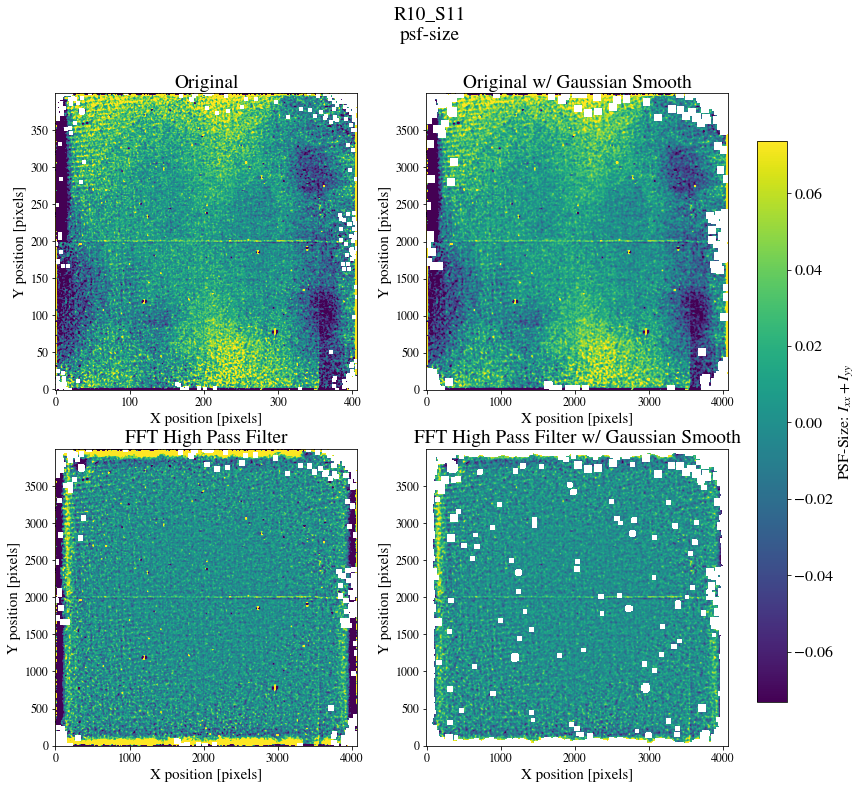

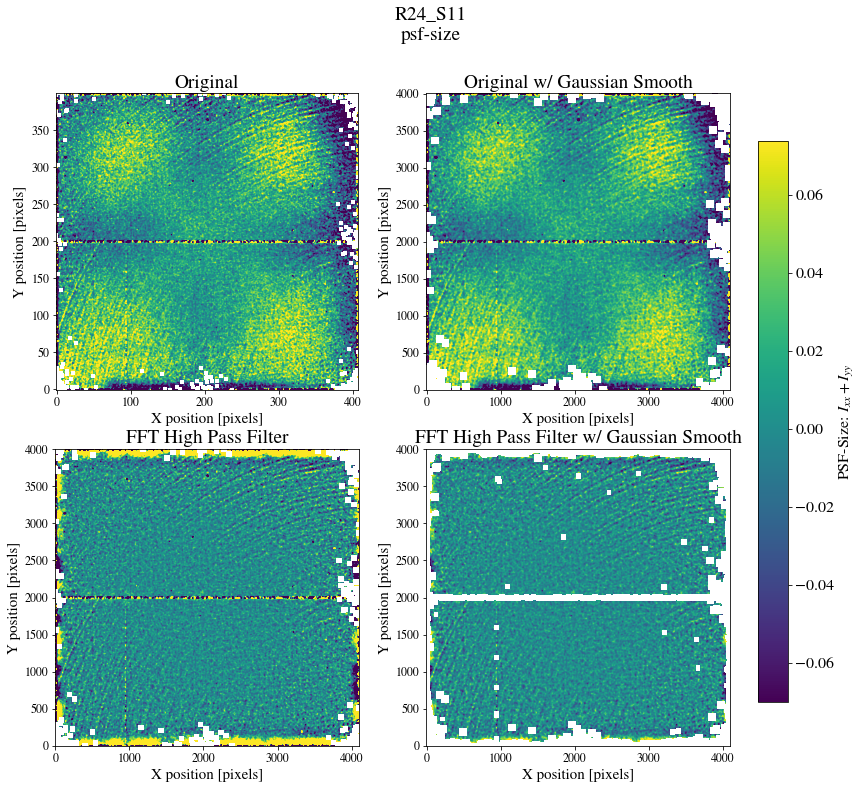

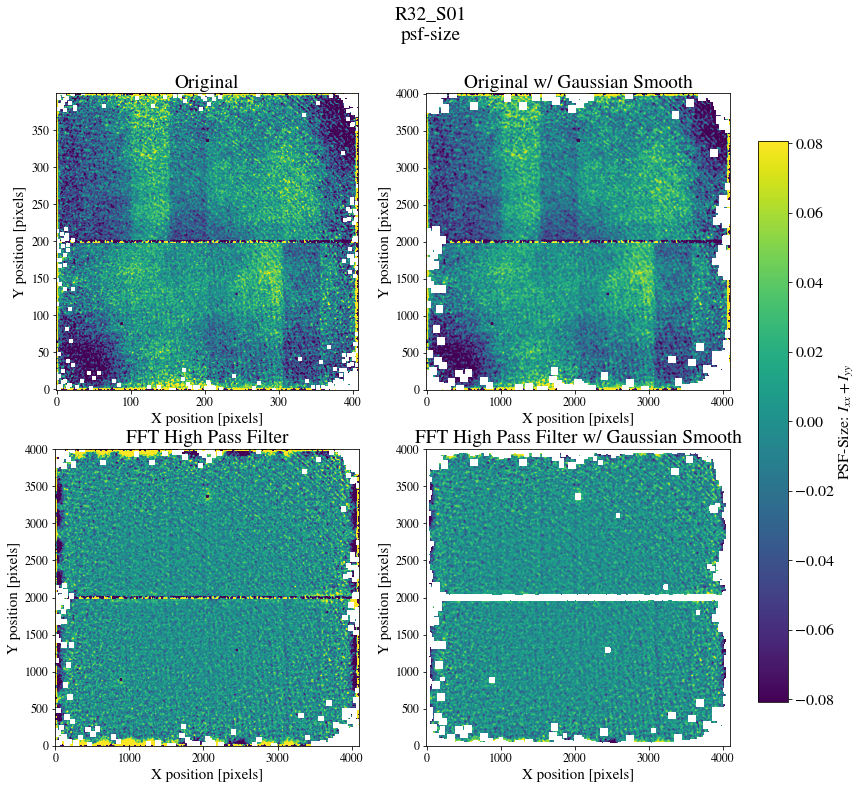

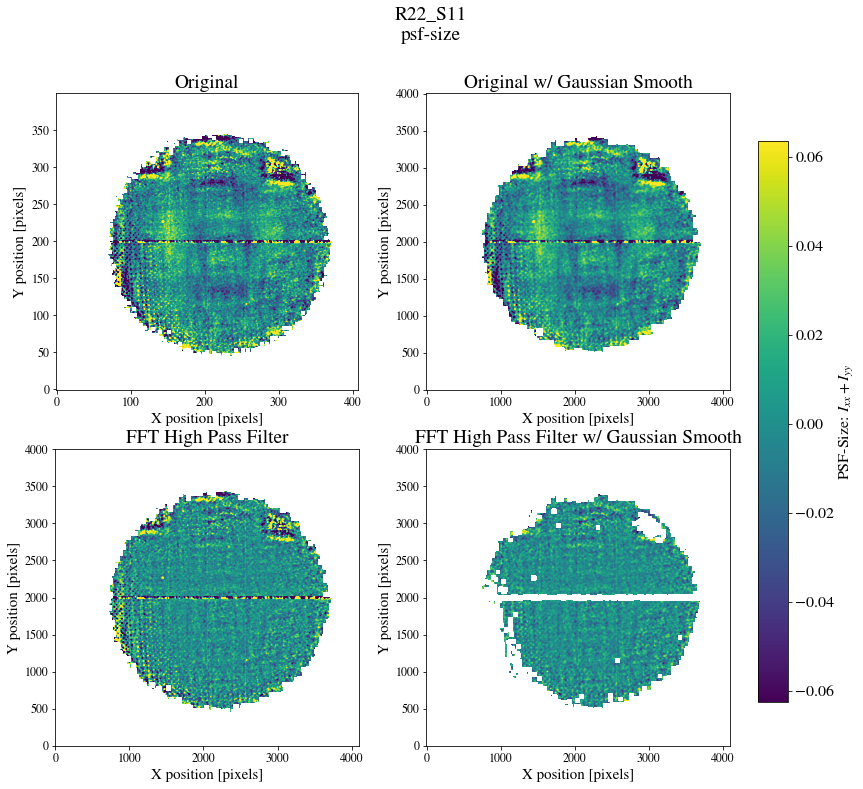

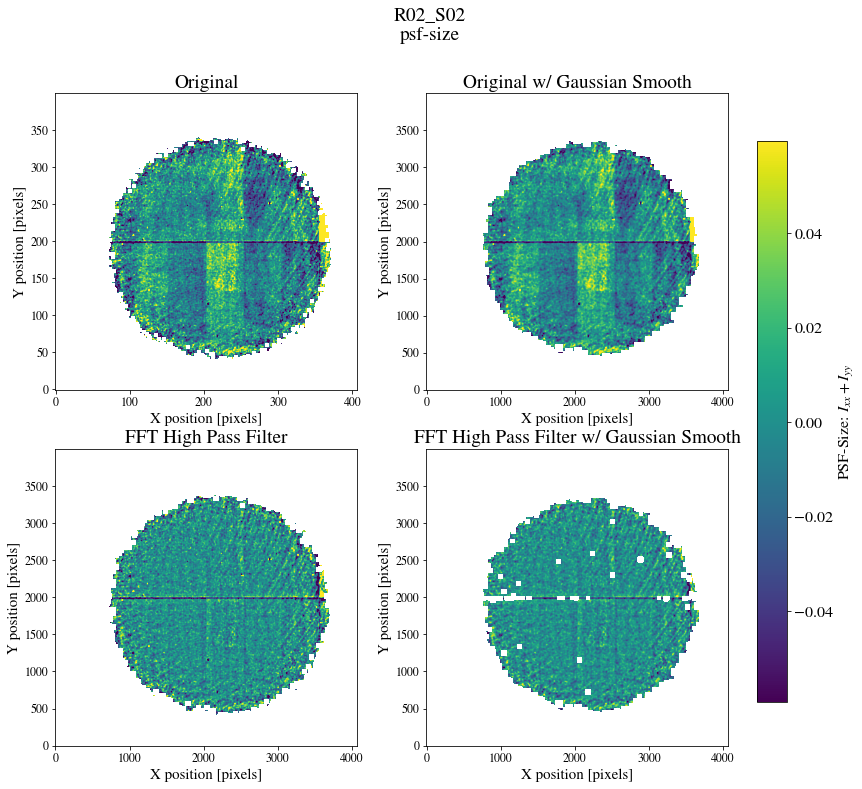

In [52]:
import datetime
import numpy as np
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib.pyplot as plt

rings = treeRings[variable]
with PdfPages('./figures/fig_distortionMap_%s_collection.pdf'%variable) as pdf:
    for ring in rings:
        ring.set_ylabel(ylabel)
        ring.variable = variable
        ring.apply_mask()
        ring.set_title()
        ring.display_images()
        pdf.savefig()
        #plt.close()
        
    d = pdf.infodict()
    d['Title'] = 'Spot Grid Images - Tree Ring Analysis'
    d['Author'] = 'Johnny Esteves'
    d['CreationDate'] = datetime.datetime.today()
    

## Ellipiticity

In [53]:
# Make Plots
variable = 'ellipticity'
component = keys[variable][0]
ylabel = keys[variable][1]
strech = keys[variable][2]

/usr/local/anaconda/lib/python3.8/site-packages/skimage/measure/block.py:86: RuntimeWarning: Mean of empty slice
  return func(blocked, axis=tuple(range(image.ndim, blocked.ndim)),


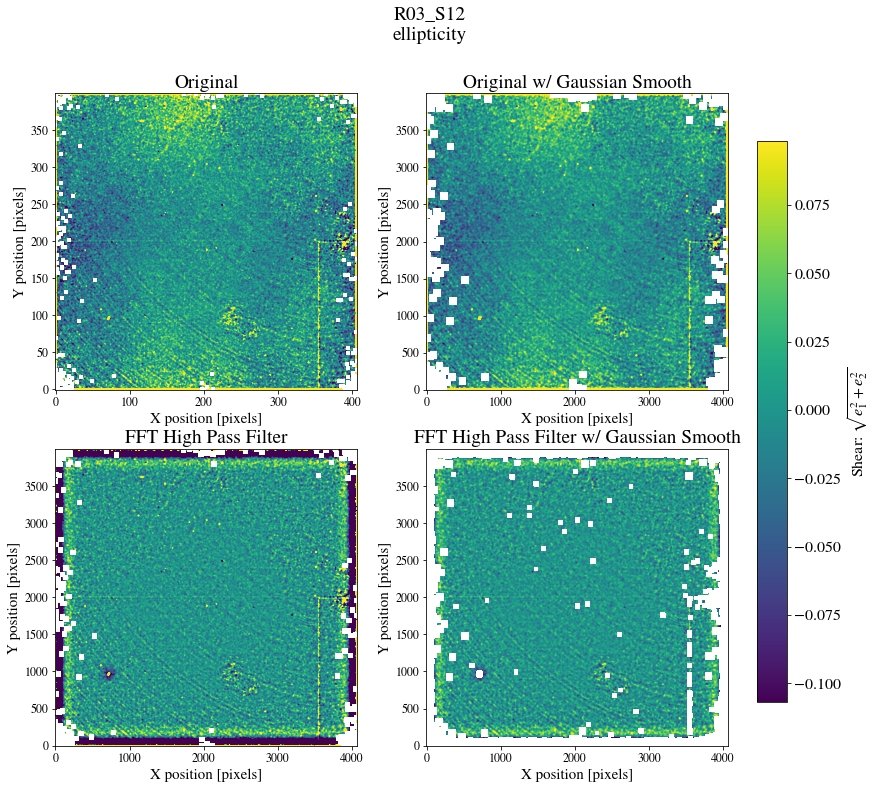

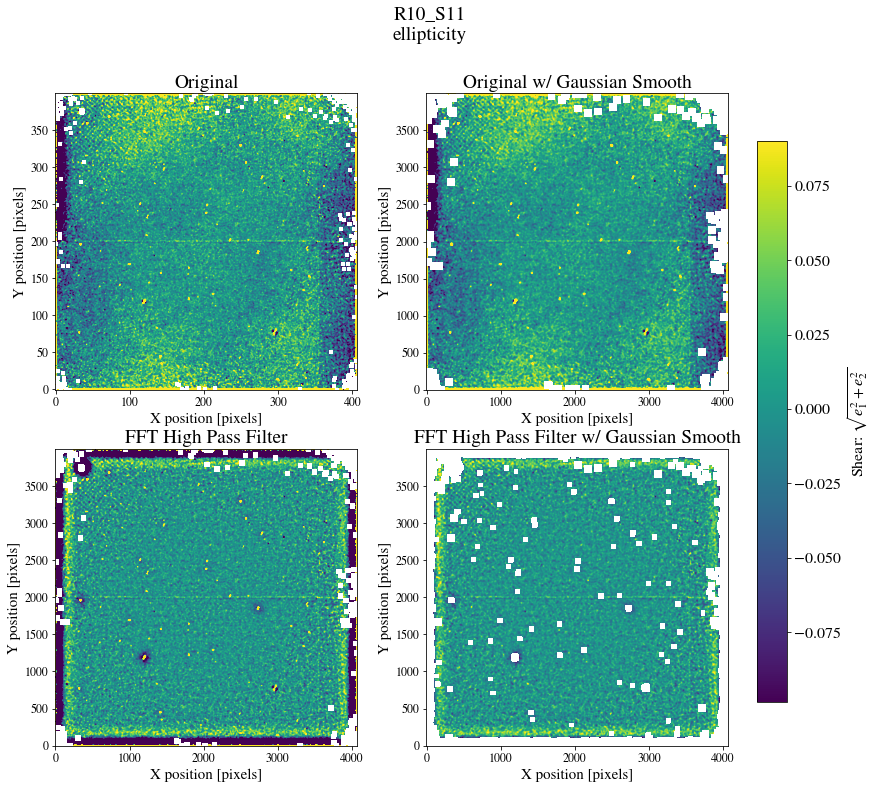

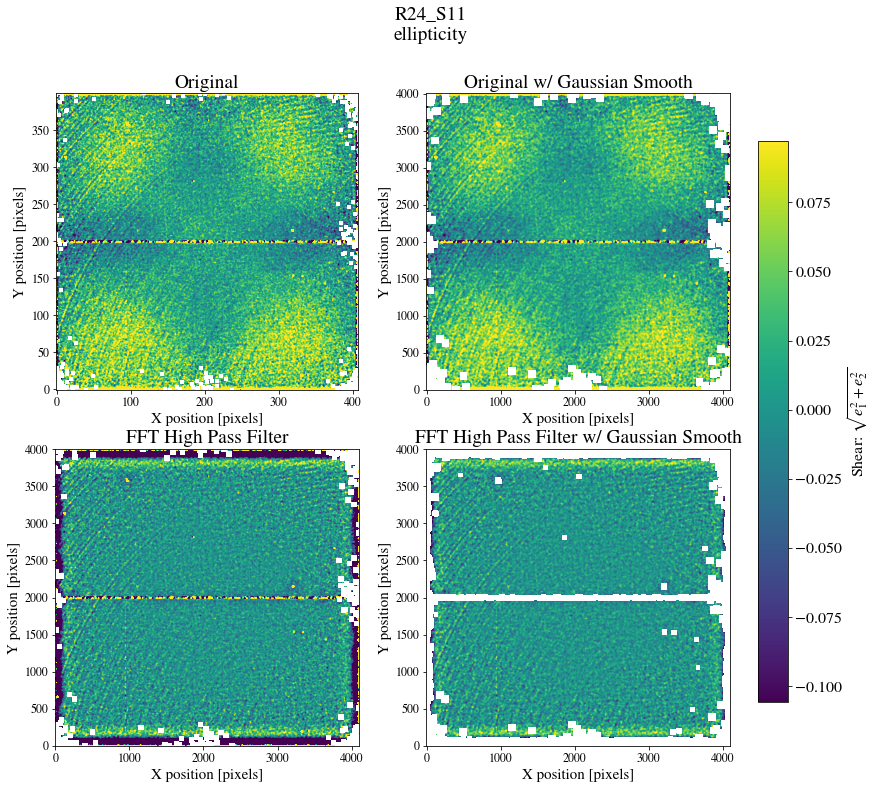

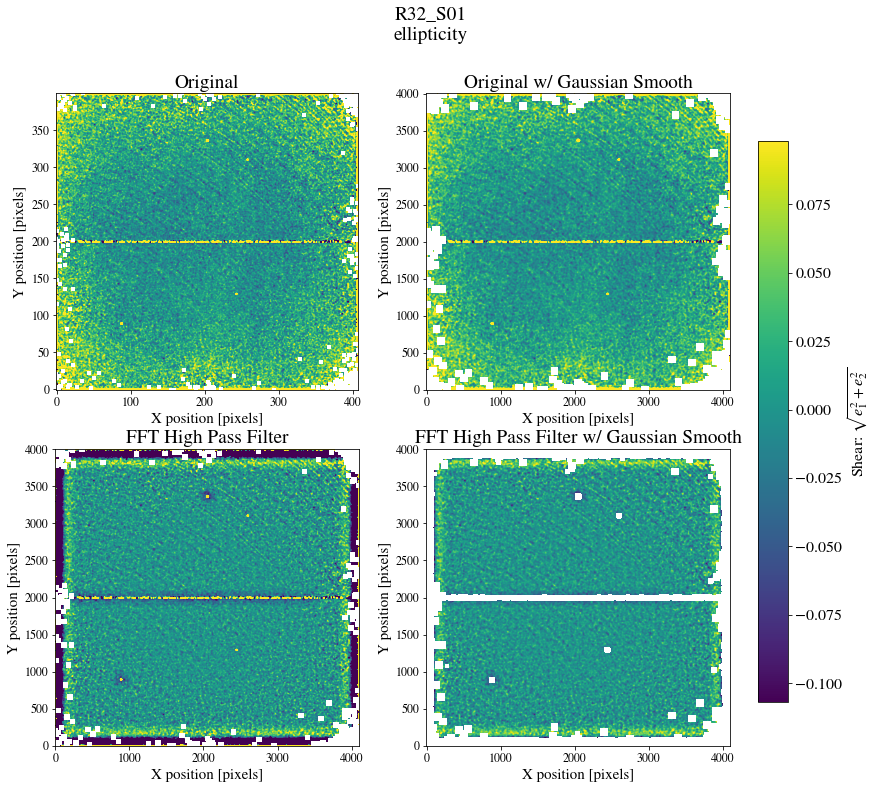

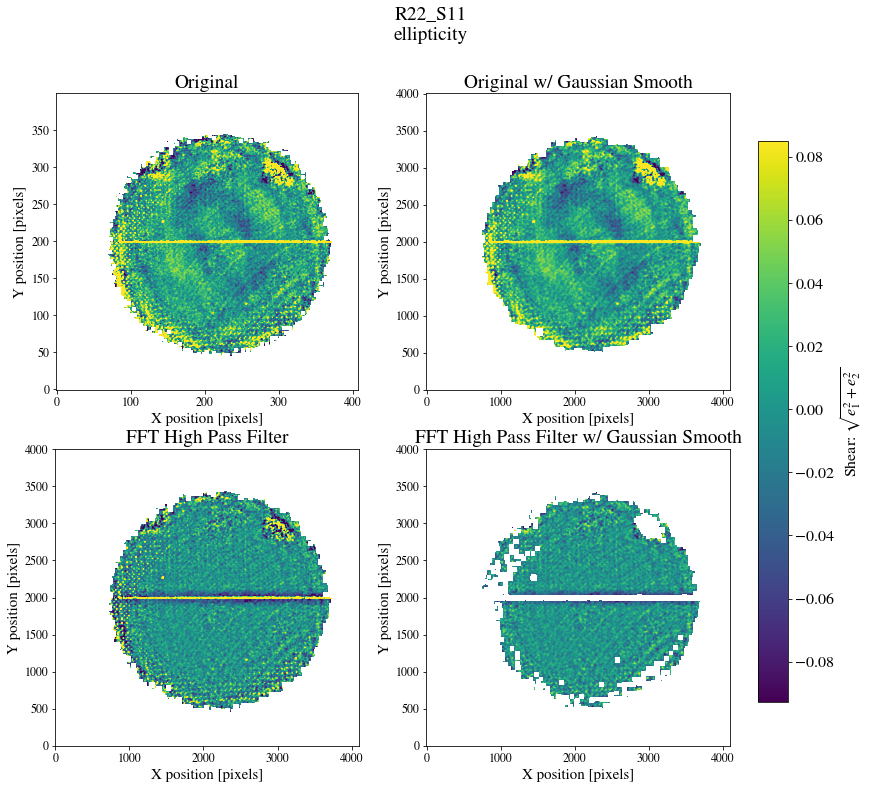

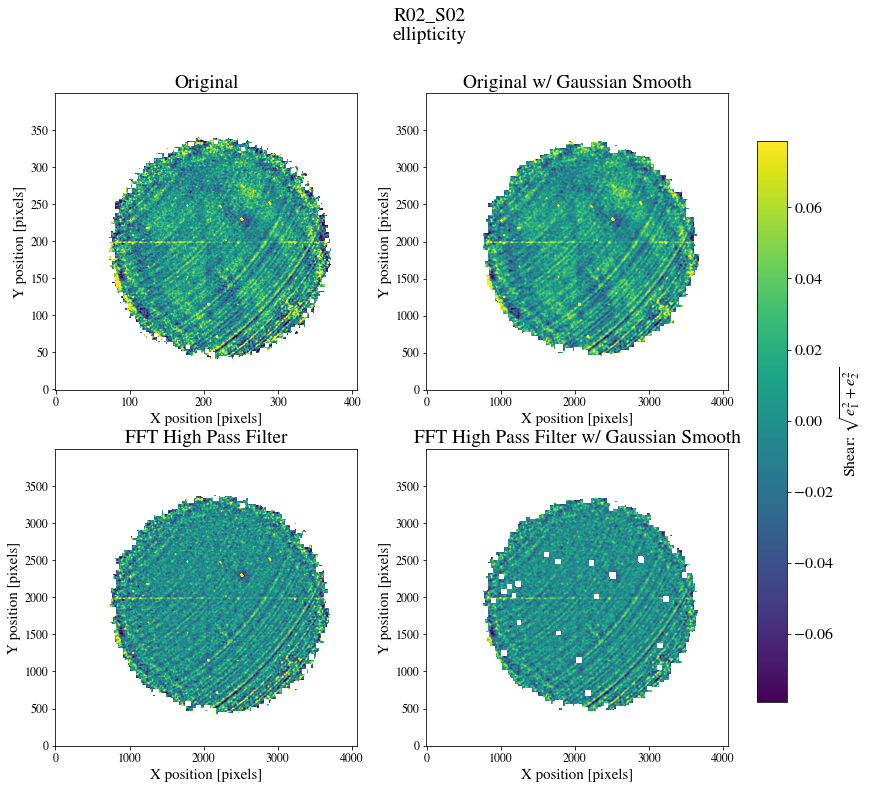

In [54]:
import datetime
import numpy as np
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib.pyplot as plt

rings = treeRings[variable]
with PdfPages('./figures/fig_distortionMap_%s_collection.pdf'%variable) as pdf:
    for ring in rings:
        ring.set_ylabel(ylabel)
        ring.variable = variable
        ring.apply_mask()
        ring.set_title()
        ring.display_images()
        pdf.savefig()
        #plt.close()
        
    d = pdf.infodict()
    d['Title'] = 'Spot Grid Images - Tree Ring Analysis'
    d['Author'] = 'Johnny Esteves'
    d['CreationDate'] = datetime.datetime.today()
    

## Flux Ratio

In [55]:
# Make Plots
variable = 'flux-ratio'
component = keys[variable][0]
ylabel = keys[variable][1]
strech = keys[variable][2]

/usr/local/anaconda/lib/python3.8/site-packages/skimage/measure/block.py:86: RuntimeWarning: Mean of empty slice
  return func(blocked, axis=tuple(range(image.ndim, blocked.ndim)),


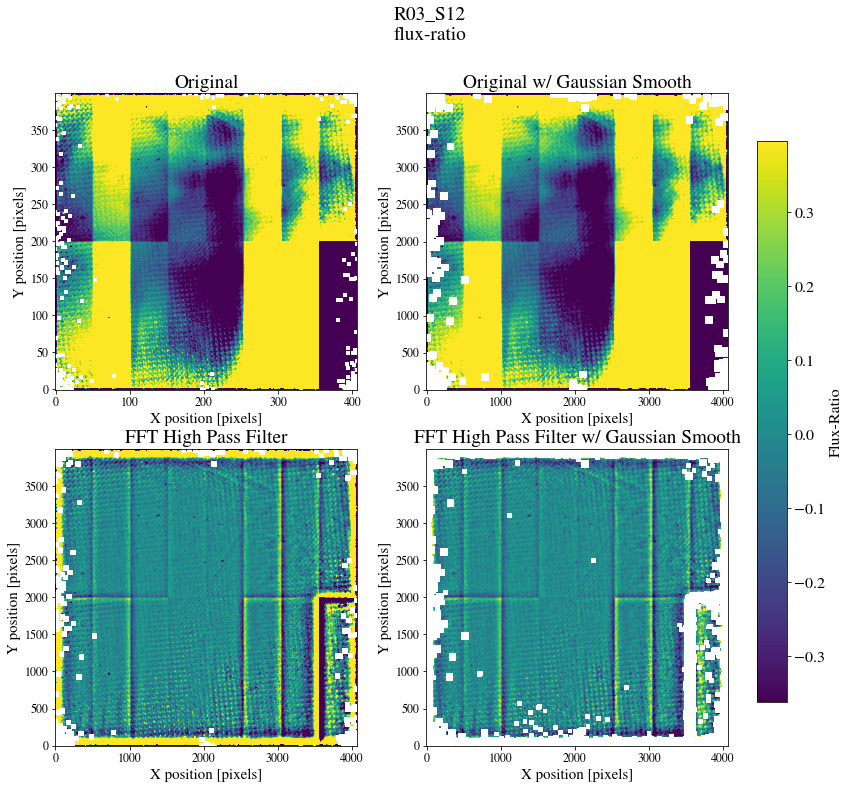

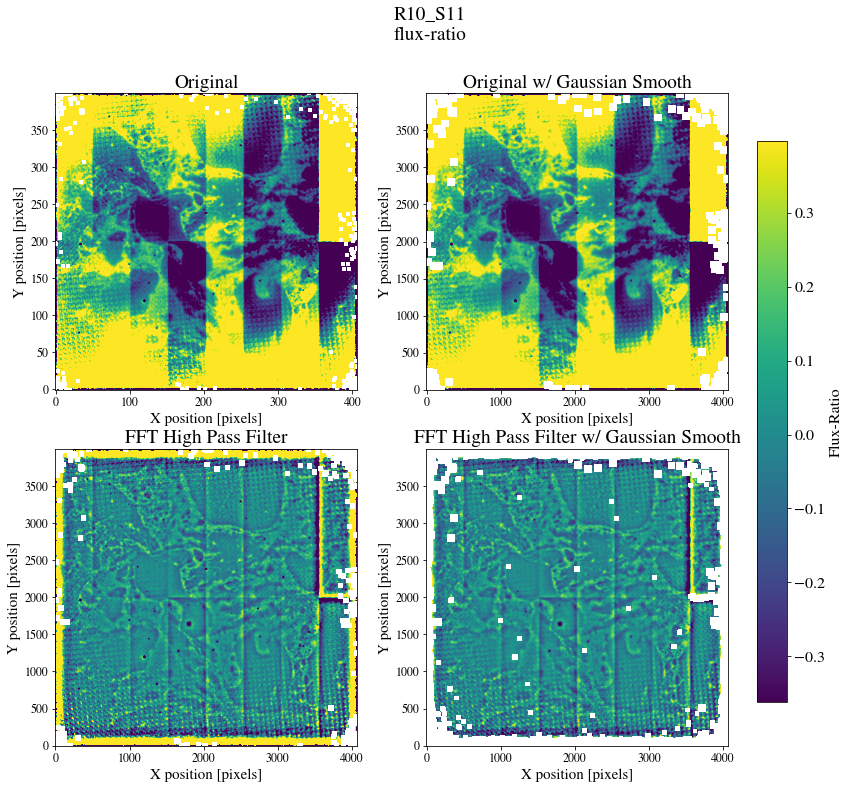

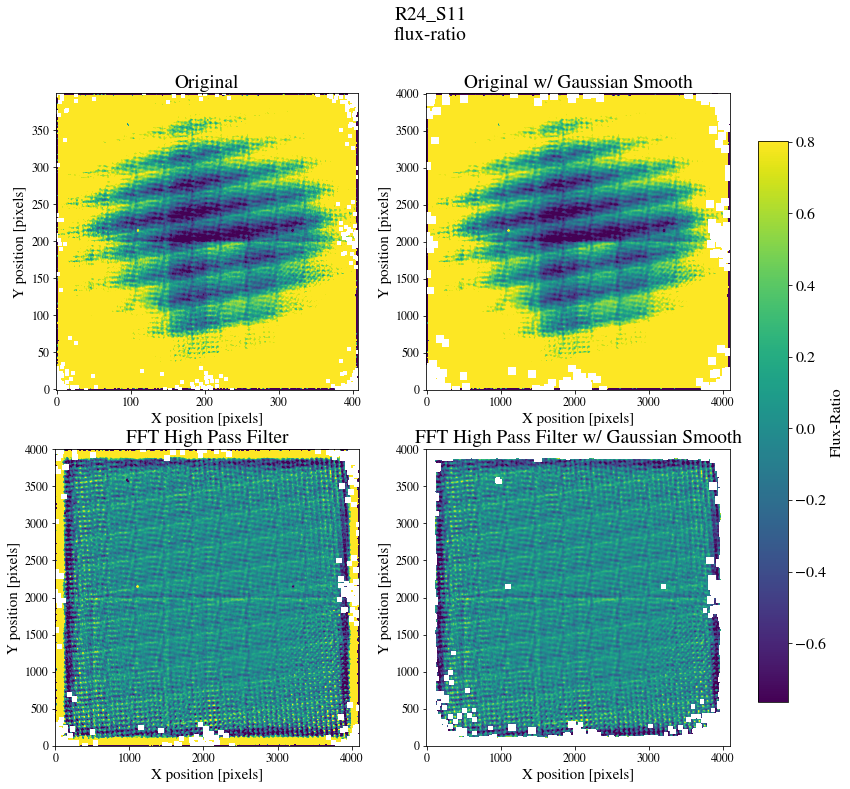

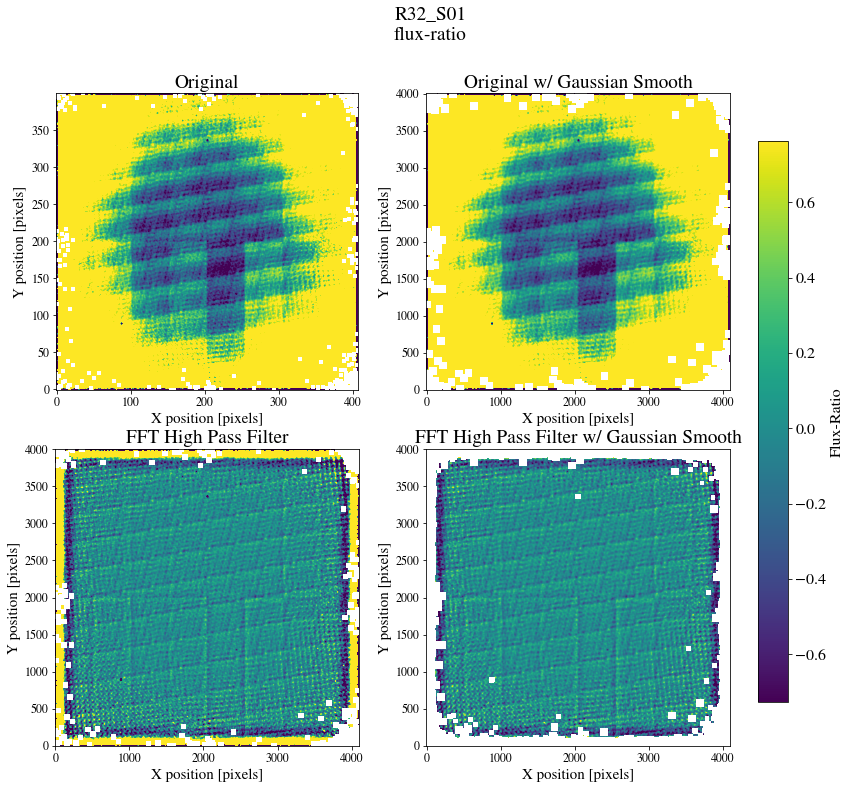

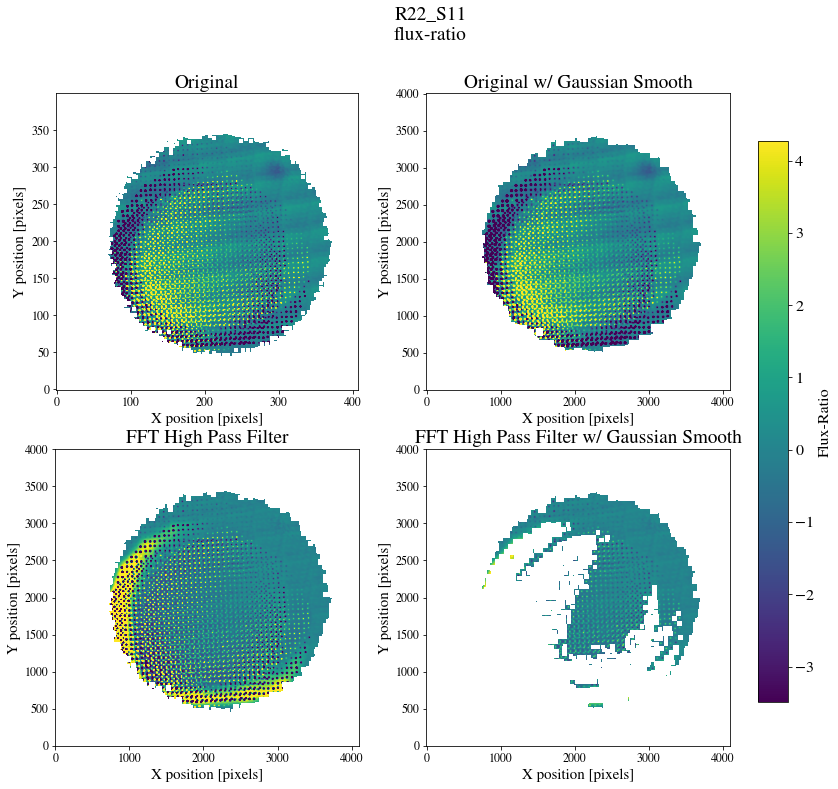

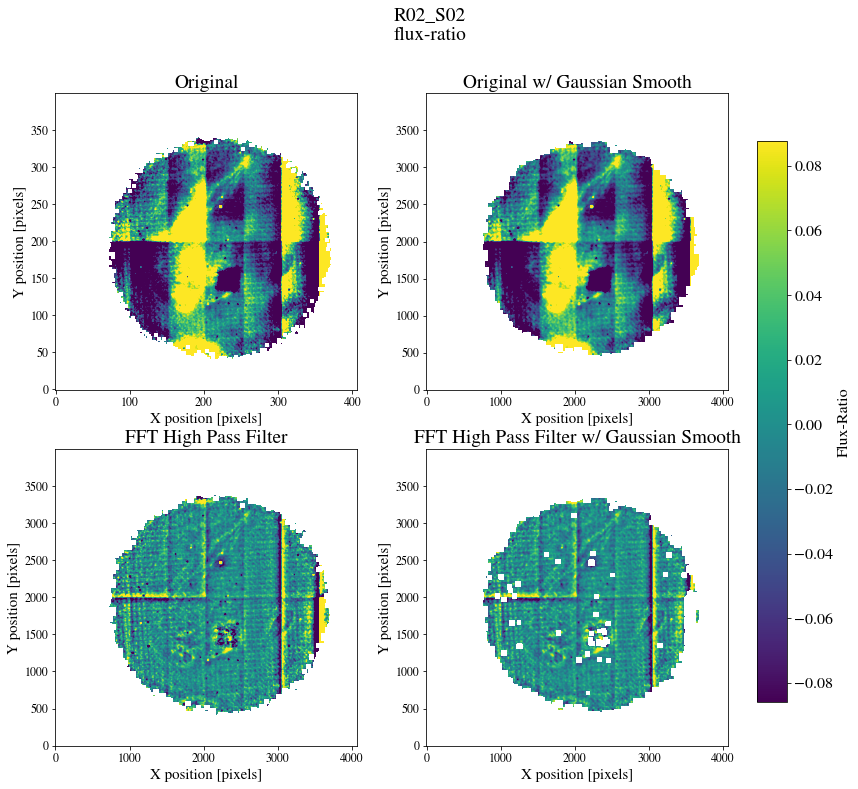

In [56]:
import datetime
import numpy as np
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib.pyplot as plt

rings = treeRings[variable]
ring = rings[-1]
with PdfPages('./figures/fig_distortionMap_%s_collection.pdf'%variable) as pdf:
    for ring in rings:
        ring.set_ylabel(ylabel)
        ring.variable = variable
        ring.apply_mask()
        ring.set_title()
        ring.display_images()
        pdf.savefig()
        #plt.close()
        
    d = pdf.infodict()
    d['Title'] = 'Spot Grid Images - Tree Ring Analysis'
    d['Author'] = 'Johnny Esteves'
    d['CreationDate'] = datetime.datetime.today()
    

# Tree Ring Profiles

In [69]:
from scipy.signal.signaltools import wiener
from scipy.signal import savgol_filter, general_gaussian
import numpy as np
from scipy.fftpack import rfft, irfft, fftfreq
import scipy

def integrate_signal(r,signal,fs=1000,window=31,p=3):
    noisy     = np.zeros_like(r)
    noisy[1:] = np.array([scipy.integrate.simps(r[:i]*signal[:i],x=r[:i])/r[i] for i in range(1,len(r))])
    
    filtered = low_pass_filter(r,noisy,freq=1/fs)
    res  = savgol_filter(filtered, window, polyorder = p, deriv=0)
    return filtered

def low_pass_filter(time,signal,freq=1/150):
    W = fftfreq(signal.size, d=time[1]-time[0])
    f_signal = rfft(signal)

    # If our original signal time was in seconds, this is now in Hz    
    cut_f_signal = f_signal.copy()
    cut_f_signal[(W<freq)] = 0

    cut_signal = irfft(cut_f_signal)
    return cut_signal

In [70]:
def plot_signal(out,ax=None,color=None,unit='%',label="",fill=False,factor=1.,
                percentage=False,alpha=0.8,ls='solid'):
    x,y,ym,yp = out[0], out[1], out[3], out[4]
    
    pr=1.
    if percentage: pr=100.
    ys = savgol_filter(y, window, polyorder = 3, deriv=0)    
    if ax is None: ax=plt.axes()
    p     = ax.plot(x, factor*ys*pr, lw=3, color=color,label=label,alpha=alpha,ls=ls)
    ax.plot(x,0.*x, 'k',ls=(0, (3, 10, 1, 10)),lw=2)
    color = p[0].get_color()
    if fill:    ax.fill_between(x,factor*pr*ym,factor*pr*yp,alpha=0.3, label=None, color=color)
        
    ax.set_xlabel('radius [pixels]',fontsize=24)
    ax.set_ylabel('dev. from mean [%s]'%(unit),fontsize=24)

In [71]:
def load_profile(variable, sensor, sensorbay):
    pdir = './profiles/'
    fname = f'{variable}_{sensor}_{sensorbay}.npy'
    print(f'fname: {fname}')
    return np.load(pdir+fname)

In [92]:
def plot_figure_4(sensor, sensorbay, border = 50, window = 71, save=False):
    title = '%s: %s'%(sensor, sensorbay)
    
    # load profiles
    dr = load_profile('astrometric-shift', sensor, sensorbay)
    dT = load_profile('psf-size', sensor, sensorbay)
    dg = load_profile('ellipticity', sensor, sensorbay)
    dF = load_profile('flatField', sensor, sensorbay)
    
    # set xlims 
    rmin, rmax = dr[0][0]-border, dr[0][-1]+border
    rmin = 2500
    
    # taking derivative
    dr2 = [dr[0]] 
    dr2+= [100.*savgol_filter(signal, window, polyorder = 3, deriv=1) for signal in dr[1:]]
    
    # make the plot
    fig, axs = plt.subplots(2, 2, figsize=(25, 2*6+2))
    fig.subplots_adjust(hspace=0.25)
    ymax = 3*np.std(dF[1])

    ax = axs[0,0]
    factor = 1.#get_factor(dF,dT)
    plot_signal(dF,label=r'$ %.2f \times $ Flat Field'%(-1*factor),
                 ax=ax,factor=-1*factor,unit='%',color=colors[-1],ls='-.')
    plot_signal(dT,label='dT',ax=ax,fill=False,color=colors[1])
    ax.legend(fontsize=16)
    ax.legend(fontsize=16)
    ax.set_xlim(rmin,rmax)
    ax.set_ylim(-ymax,ymax)
    ax.set_title('PSF-Size', fontsize=24)

    ax = axs[0,1]
    factor = 1.
    plot_signal(dF,label=r'$ %.2f \times $ Flat Field'%(-1*factor),
                 ax=ax,factor=-1*factor,unit='%',color=colors[-1],ls='-.')
    plot_signal(dg,label=r'$\gamma$',ax=ax,fill=False,color=colors[2])
    ax.legend(fontsize=20)
    #ymax = 3*np.std(dg[1])
    ax.legend(fontsize=20)
    ax.set_xlim(rmin,rmax)
    ax.set_ylim(-ymax,ymax)
    ax.set_title('Shear', fontsize=24)

    ax     = axs[1,0]
    factor = 1.
    plot_signal(dF,label=r'$%.2f \times$ %s'%(-1*factor,'Flat Field'),ax=ax,
                factor=-1*factor, fill=False,unit='%',color=colors[-1],ls='-.')
    plot_signal(dr2,label='$\partial_r f(r)$',ax=ax,fill=True,color=colors[5])
    #ymax = 3*np.std(dr2[1])
    ax.legend(fontsize=16)
    ax.set_xlim(rmin,rmax)
    ax.set_ylim(-ymax,ymax)
    ax.set_title('Astrometric Shift', fontsize=24)

    ax = axs[1,1]
    factor = 1.#get_factor(dT,dr2,is_range=False)
    plot_signal(dT,label=r'%s'%('dT'),ax=ax,factor=+1.,fill=False,unit='%',color=colors[1])
    plot_signal(dg,label=r'%s'%('$\gamma$') ,ax=ax,factor=+1.,fill=False,unit='%',color=colors[2],ls='-.')
    plot_signal(dr2,label=r'$\partial_r f(r)$',ax=ax,fill=False,color=colors[5],ls='--')
    ax.legend(fontsize=20)

    #ymax = 3*np.std(dr2[1])
    ax.legend(fontsize=20)
    ax.set_xlim(rmin,rmax)
    ax.set_ylim(-ymax,ymax)
    ax.set_title(title+' - Signal Comparasion', fontsize=24)
    fig.suptitle('Tree Ring Signal - '+title, fontsize=24)
    if save:
        fig.savefig('../figures/fig_treeRing_Signal_%s.pdf'%sensorbay, dpi=100, format='pdf', bbox_inches='tight')


In [93]:
colors = ['#E74C3C','#8E44AD','#3498DB','#16A085','#16A085','#000080','k']

wlabel= r'$\frac{1}{r}\int_{0}^{r} r^\prime w(r^\prime) dr^\prime$'
dtlabel= r'$\frac{1}{r}\int_{0}^{r} r^\prime dT(r^\prime) dr^\prime$'
dglabel= r'$\frac{1}{r}\int_{0}^{r} r^\prime \gamma(r^\prime) dr^\prime$'

In [ ]:
from matplotlib.backends.backend_pdf import PdfPages

window=71
with PdfPages('./figures/fig_treeRing_Signal_collection.pdf') as pdf:
    for asensor in sensors:
        sensorbay, sensor = asensor.sensor, asensor.sensorbay
        print('Plot %s'%sensorbay)
        plot_figure_4(sensorbay, sensor)
        pdf.savefig()
        print('')

## Define new auxialiary functions

In [ ]:
def compute_ellipticities(self):
    nanmask = np.isfinite(self.deltaXX) #masks all the NaN entries created when a catalog didn't have 2401 entries

    e0_total = self.xx_arr+self.yy_arr
    e1_total = (self.xx_arr-self.yy_arr)#/e0_total
    e2_total = 2*self.xy_arr#/e0_total
    en_total = np.sqrt(e1_total**2+e2_total**2)
    
    # Ixx,cal = Ixx - dIxx
    e0_cal = (self.xx_arr+self.yy_arr) - (self.dxx_arr+self.dyy_arr)
    e1_cal = (self.xx_arr-self.yy_arr) - (self.dxx_arr-self.dyy_arr)
    e2_cal = 2*self.xy_arr - 2*self.dxy_arr
    en_cal = np.sqrt(e1_cal**2+e2_cal**2)
    
    ## calibrating the measurements
    de0_all = (e0_total[self.spot_filter]-e0_cal[self.spot_filter])/e0_cal[self.spot_filter]
    de1_all = (e1_total[self.spot_filter]-e1_cal[self.spot_filter])/e0_cal[self.spot_filter]
    de2_all = (e2_total[self.spot_filter]-e2_cal[self.spot_filter])/e0_cal[self.spot_filter]
    den_all = (en_total[self.spot_filter]-en_cal[self.spot_filter])/e0_cal[self.spot_filter]

    self.e0 = de0_all[nanmask].flatten()
    self.e1 = de1_all[nanmask].flatten()
    self.e2 = de2_all[nanmask].flatten()
    self.shear = den_all[nanmask].flatten()
    
    return self

In [ ]:
from collections import defaultdict
def get_imaging_map(self):
    dmap = defaultdict()
    nanmask = np.isfinite(self.deltaXX)  #masks all the NaN entries created when a catalog didn't have 2401 entries
    xxfltr_flat = self.xxfltr[nanmask].flatten()
    yyfltr_flat = self.yyfltr[nanmask].flatten()
    
    # flux-ratio
    mydict = dict().fromkeys(['abs'])
    mydict['abs'] = self.dF
    dmap['flux-ratio'] = mydict
    
    # astrometric-shift
    mydict = dict().fromkeys(['x','y','abs'])
    mydict['x'] = self.dX
    mydict['y'] = self.dY
    mydict['abs'] = np.sqrt(self.dX**2+self.dY**2)
    dmap['astrometric-shift'] = mydict
        
    # psf-size
    mydict = dict().fromkeys(['x','y','abs'])
    mydict['x'] = self.dXX/(xxfltr_flat+yyfltr_flat)
    mydict['y'] = self.dYY/(xxfltr_flat+yyfltr_flat)
    mydict['abs'] = mydict['x']+mydict['y']
    dmap['psf-size'] = mydict
    
    # ellipticity
    mydict = dict().fromkeys(['x','y','abs','abs_diff'])
    mydict['x'] = self.e1
    mydict['y'] = self.e2
    mydict['abs'] = np.sqrt(mydict['x']**2+mydict['y']**2)
    mydict['abs_diff'] = self.shear
    dmap['ellipticity'] = mydict

    self.data = dmap
    return self

In [ ]:
def transform_to_treeRing_coords(self,fname='tr_center_flatField_Volt0.csv'):
    # transform to the TR coordinate system    
    # tr-center look-up table
    tr_center_lut = read_tr_center_table(fname)
    self.tr_xc, self.tr_yc = tr_center_lut[itl.sensorbay]

    r, t = trasnform_to_polar_coord(self.xfltr_flat,self.yfltr_flat, x0=self.tr_xc, y0=self.tr_yc)

    dr,dt= proj_to_polar_coord(t,self.data['astrometric-shift']['x'],self.data['astrometric-shift']['y'])
    self.data['astrometric-shift']['r'] = dr
    self.data['astrometric-shift']['t'] = dt

    dr,dt= proj_to_polar_coord(t,self.data['psf-size']['x'],self.data['psf-size']['y'])
    self.data['psf-size']['r'] = dr
    self.data['psf-size']['t'] = dt

    # for spin2 quantities 
    dr,dt= proj_to_polar_coord_spin2(t,self.data['ellipticity']['x'],self.data['ellipticity']['y'])
    self.data['ellipticity']['r'] = dr
    self.data['ellipticity']['t'] = dt
        
    self.data['flux-ratio']['r'] = self.data['flux-ratio']['abs']
    return self

## Testing the new classes

In [ ]:
from spotgrid_butler_new import SpotgridCatalog

In [ ]:
repo25 = '/sdf/group/lsst/camera/IandT/repo_gen3/BOT_data/butler.yaml'
repo9 = '/sdf/group/lsst/camera/IandT/repo_gen3/spot_9raft/butler.yaml'

setting = [
    (repo25, 'u/snyder18/spot_13242/gridfit_run1', 'u/snyder18/spot_13242/gridcalibration'),
    (repo25, 'u/snyder18/spot_13243/gridfit_run1', 'u/snyder18/spot_13243/gridcalibration'),
    (repo25, 'u/snyder18/spot_13237/gridfit_run1', 'u/snyder18/spot_13237/gridcalibration'),
    (repo25, 'u/snyder18/spot_13246/gridfit_run1', 'u/snyder18/spot_13246/gridcalibration'),
    (repo9, 'u/asnyder/spot/e2v_analysis', 'u/asnyder/spot/e2v_calibration'),        
    (repo9, 'u/asnyder/spot/itl_analysis', 'u/asnyder/spot/itl_calibration')]

In [ ]:
idx = 5
mysetting = setting[idx]

In [ ]:
print('Starting with setting')
print(',\n'.join(mysetting))

In [ ]:
sensor = SpotgridCatalog(*mysetting)

#asensor.get_calibration_table()
sensor.load_data()
sensor.compute_statistics()
sensor.filter_spots(value=.4)   # value=.4
sensor.compute_spotgrid()
sensor.calibrate()

In [ ]:
# new functions
sensor.compute_ellipticities()
sensor.get_imaging_map()    
sensor.transform_to_treeRing_coords()

In [ ]:
# plt.axvline(vmax)
for i in [0,4,5]:
    sensor = sensors[i]
    plt.scatter(sensor.xxyy_err,(sensor.instFlux_med))
    plt.plot([0.,0.6],[0.1*np.max((sensor.instFlux_med)),0.1*np.max(sensor.instFlux_med)],'--')
    plt.xlabel('$RMS(I_{xx}+I_{yy})$')
    plt.ylabel('Flux')
    plt.yscale('log')

## Check Tree Ring

In [ ]:
keys = {
        'astrometric-shift':['r','Astrometric Shift [pixels]',1.],
        'flux-ratio':['abs','Flux-Ratio', 100.],
        'psf-size':['abs','PSF-Size: $I_{xx}+I_{yy}$',100.],
        'ellipticity':['r','Shear: $\\sqrt{e_1^2+e_2^2}$',100.]
       }

In [ ]:
variable='ellipticity'
component = keys[variable][0]
ylabel = keys[variable][1]
strech = keys[variable][2]

In [ ]:
### Checking TR Class
import tree_ring_helper as tr
ring = tr.tree_ring_tools(sensor)

In [ ]:
# astrometric-shift in the radial direction of the TR coord. system
ring.make_image(variable, component, fradius=140)
ring.apply_strech(strech)

In [ ]:
## image processing: high pass filter and smooth; 
## always run in the following order
ring.apply_high_freq_filter()
ring.apply_gaussian_filter(downscale=4)
ring.apply_mask(threshold=0.5)


In [ ]:
## warpPolar transformation signal analysis
ring.make_polar_transformation()
ring.compute_signal()


In [ ]:
## bining signal analysis
ring.make_profile(ring.diff,step=1)

In [ ]:
## save output
ring.save_profile(variable)

## Ploting Functions

In [ ]:
# ring.set_levels([-0.2, 0.2])
ring.set_ylabel(ylabel)
ring.display_images()

In [ ]:
ring.check_ccd_center_plot(ring.diff1)

In [ ]:
ring.check_polar_transfomartion()

In [ ]:
ring.plot_superposition_polar_signal()

In [ ]:
ring.plot_pannel_image_signal()

# Review Filter Spot Threshold

```
self.spot_filter = (
        (self.xxyy_err < value )
        & (self.instFlux_med > 0.5*np.nanmax(self.instFlux_med) )
    )
```

In [ ]:
sensor = sensors[0]
mask0 = sensor.xxyy_err < vmax
mask1 = sensor.instFlux_med > 0.3*np.nanmax(sensor.instFlux_med)

In [ ]:
_ = plt.hist(sensor.xxyy_err,bins=100)
_ = plt.hist(sensor.xxyy_err[mask1],bins=_[1])
vmin, vmax = get_outlier_lims(sensor.xxyy_err[mask1],n=1.5)
print(vmax)
plt.axvline(vmax,color='k',ls='--')

In [ ]:
plt.axvline(vmax)
for i in [0,-2,-1]:
    sensor = sensors[i]
    plt.scatter(sensor.xxyy_err,(sensor.instFlux_med))
    plt.plot([0.,0.6],[0.1*np.max((sensor.instFlux_med)),0.1*np.max(sensor.instFlux_med)],'--')
    plt.xlabel('$RMS(I_{xx}+I_{yy})$')
    plt.ylabel('Flux')
    plt.yscale('log')

In [ ]:
sensor = sensors[0]
# xxyy_err = np.sqrt(xx_std**2+yy_std**2)
_ = plt.hist(np.log10(sensor.instFlux_med),bins=100)
_ = plt.hist(np.log10(sensor.instFlux_med)[mask],bins=_[1])
# _ = plt.hist(sensor.xx_std,bins=100)
# _ = plt.hist(sensor.xx_std,bins=100)
# vmin, vmax = get_outlier_lims(np.log(sensor.instFlux_med))
plt.axvline(np.log10(0.5*np.nanmax(sensor.instFlux_med)),color='k',ls='--')

# Figure 1

In [ ]:
# This cell comes from tree_ring_helper.py to override for handy
sensor_lims = {'e2v':[[0,4096],[0,4004]],'ITL':[[0,4072],[0,4000]]}

import scipy
import cv2
from astropy.stats import mad_std

def generate_image(self,datatype,component,MAX=0.07,fradius=140,bins = [407,400]): 
    '''
    Generetates a pseudo image
    self: spotgrid_class_object
    datatye: 'psf-size', 'astrometric-shift', ...
    component: x, y, r, t, abs, abs_diff
    '''
    #[407, 400] approx. 10x10 px^2 binning
    dmap = self.data[datatype]
    
    dT_mean, x_edge, y_edge, binidx = binned_statistic_2d(
                                    self.xfltr_flat,
                                    self.yfltr_flat,
                                    dmap[component],
                                    lambda x: scipy.stats.norm.fit(x[np.isfinite(x)])[0],
                                    range=sensor_lims[self.sensor], bins=bins)    
    ## sensor max limits
    xmax = sensor_lims[self.sensor][0][1]
    ymax = sensor_lims[self.sensor][1][1]
    
    ## resize image
    resized     = cv2.resize(dT_mean.T,(xmax,ymax), interpolation = cv2.INTER_AREA)
    return dT_mean,resized

In [ ]:
keys = {
        'astrometric-shift':['abs','Astrometric Shift [pixels]'],
        'flux-ratio':['abs','Flux-Ratio'],
        'psf-size':['abs','PSF-Size: $I_{xx}+I_{yy}$'],
        'ellipticity':['abs_diff','Shear: $\\sqrt{e_1^2+e_2^2}$']
       }


In [ ]:
nsigma = 3
prop = 3/4.

In [ ]:
fig, axs = plt.subplots(2, 2, figsize=(16, 16*prop + 1), sharey='all', facecolor="white")

fig.suptitle(f'{sensor.sensorbay.upper()} {sensor.sensor}')
# maps = {}
for ax, key, vals in zip(axs.flatten(), keys, keys.values()):
    #print(5*'---')
    #print(f'Variable: {key}')
    #print(f'component: {vals[0]}\n')
    
    _, img =  generate_image(sensor, key, vals[0], bins=[407,400])
    img_filtered = gaussian_filter(img,3)
    #img_filtered = apply_filter(img, 250, power=4) # power was 4
    
    std=mad_std(img_filtered, ignore_nan=True)
    m=np.nanmedian(img_filtered)
    a=ax.imshow(img_filtered,vmin=m-nsigma*std,vmax=m+nsigma*std)
    fig.colorbar(a,ax=ax)
    ax.set_title(vals[1])

fig.tight_layout()
plt.show()
fig.savefig(f'{sensor.sensorbay}_figure1.pdf',dpi=100)

In [ ]:
sensors = []
for mysetting in setting:
    sensor = SpotgridCatalog(*mysetting)

    #asensor.get_calibration_table()
    sensor.load_data()
    sensor.compute_statistics()
    sensor.filter_spots(value=.4)   # value=.4
    sensor.compute_spotgrid()
    sensor.calibrate()
    # new quantities
    sensor = compute_ellipticities(sensor)
    sensor = get_imaging_map(sensor)

    sensors.append(sensor)

In [ ]:
for sensor in sensors:
    fig, axs = plt.subplots(2, 2, figsize=(16, 16*prop + 1), sharey='all', facecolor="white")

    fig.suptitle(f'{sensor.sensorbay.upper()} {sensor.sensor}')
    # maps = {}
    for ax, key, vals in zip(axs.flatten(), keys, keys.values()):
        #print(5*'---')
        #print(f'Variable: {key}')
        #print(f'component: {vals[0]}\n')

        _, img =  generate_image(sensor, key, vals[0], bins=[407,400])
        img_filtered = gaussian_filter(img,3)
        #img_filtered = apply_filter(img, 250, power=4) # power was 4

        std=mad_std(img_filtered, ignore_nan=True)
        m=np.nanmedian(img_filtered)
        a=ax.imshow(img_filtered,vmin=m-nsigma*std,vmax=m+nsigma*std)
        fig.colorbar(a,ax=ax)
        ax.set_title(vals[1])

    fig.tight_layout()
    plt.show()
    fig.savefig(f'{sensor.sensorbay}_figure1.pdf',dpi=100)

# Tree Ring Coordiante System

In [ ]:
import pandas as pd
def read_tr_center_table(fname='tr_center_flatField_Volt0.csv'):
    df = pd.read_csv(fname)
    myvalues = df[['ID','x0','y0']].to_dict('list')
    out = {}
    for i,idi in enumerate(myvalues['ID']):
        out[idi] = [myvalues['x0'][i],myvalues['y0'][i]]
    return out

In [ ]:
import tree_ring_helper as tr

In [ ]:
def proj_to_polar_coord(t,vx,vy):
    vr = np.cos(t)*vx + np.sin(t)*vy
    vt = -np.sin(t)*vx+ np.cos(t)*vy
    return vr, vt

def proj_to_polar_coord_spin2(t,vx,vy):
    vr = np.cos(2*t)*vx + np.sin(2*t)*vy
    vt = np.sin(2*t)*vx - np.cos(2*t)*vy
    return vr, vt

def trasnform_to_polar_coord(x,y,x0=0.,y0=0.,deg=False):
    r = np.hypot((x-x0),(y-y0))
    t = np.arctan2((y-y0),(x-x0))
    
    if deg: t *= (180 / np.pi)
    return r,t

In [ ]:
# centers = [[-335.49, 4095.84],[-156,-280],[4320,4180],[4627.47, -630.89]]
centers = tr.centers
print('Tree Ring Centers')
print("\n".join(map(str, centers)))

In [ ]:
#sensor_lims = {'e2v':[[0,4096],[0,4004]],'ITL':[[0,4072],[0,4000]]}
sensor_lims = tr.sensor_lims
print('Sensor Limits')
print("\n".join(map(str, sensor_lims.values())))

In [ ]:
def transform_to_treeRing_coords(self,fname='tr_center_flatField_Volt0.csv'):
    # transform to the TR coordinate system    
    # tr-center look-up table
    tr_center_lut = read_tr_center_table(fname)
    self.tr_xc, self.tr_yc = tr_center_lut[itl.sensorbay]

    r, t = trasnform_to_polar_coord(self.xfltr_flat,self.yfltr_flat, x0=self.tr_xc, y0=self.tr_yc)

    dr,dt= proj_to_polar_coord(t,self.data['astrometric-shift']['x'],self.data['astrometric-shift']['y'])
    self.data['astrometric-shift']['r'] = dr
    self.data['astrometric-shift']['t'] = dt

    dr,dt= proj_to_polar_coord(t,self.data['psf-size']['x'],self.data['psf-size']['y'])
    self.data['psf-size']['r'] = dr
    self.data['psf-size']['t'] = dt

    # for spin2 quantities 
    dr,dt= proj_to_polar_coord_spin2(t,self.data['ellipticity']['x'],self.data['ellipticity']['y'])
    self.data['ellipticity']['r'] = dr
    self.data['ellipticity']['t'] = dt
        
    self.data['flux-ratio']['r'] = self.data['flux-ratio']['abs']
    return self

## Tree Ring Analysis - Debug

In [ ]:
sensor = sensors[1]
# component = 'psf-size'
# component = 'flux-ratio'
component = 'astrometric-shift'
sensor = transform_to_treeRing_coords(sensor)

In [ ]:
sensor.trSignal = tr.tree_ring_tools(sensor=sensor.sensor, loc=sensor.tr_orientation)

In [ ]:
_, img =  generate_image(sensor, component, 'r', bins=[407,400])
img_filtered = tr.apply_filter(img, 250, power=4) # power was 4

sensor.trSignal.img  = img   ## image
sensor.trSignal.img_cut  = img   ## image
sensor.trSignal.diff = img_filtered ## image wo borders

sensor.trSignal.apply_gaussian_filter(downscale=4)
sensor.trSignal.apply_mask(downscale=4, threshold=0.175)

In [ ]:
out = read_tr_center_table()
sensor.trSignal.xc, sensor.trSignal.yc = out[sensor.sensorbay]

In [ ]:
sensor.trSignal.check_ccd_center_plot(sensor.trSignal.diff)
# check the center

In [ ]:
np.nanstd(sensor.trSignal.img)

In [ ]:
sensor.trSignal.make_polar_transformation(rborder=100.)
sensor.trSignal.check_polar_transfomartion()

In [ ]:
sensor.trSignal.set_ylabel(r'(mean - signal)/signal')
sensor.trSignal.set_levels([-0.025/10.,0.025/10.])
sensor.trSignal.display_images()

In [ ]:
sensor.trSignal.compute_signal(zeroNan=True)
sensor.trSignal.plot_superposition_polar_signal()
plt.xlim(3100,)

In [ ]:
sensor.trSignal.plot_pannel_image_signal()
plt.xlim(1000,)
plt.ylim(-0.015,0.015)

In [ ]:
trSignal.sensorbay = sensor.sensorbay
save_profile(trSignal,component)

In [ ]:
def save_profile(self,var):
    sm = np.nanpercentile(self.polar_cut,25,0)
    sp = np.nanpercentile(self.polar_cut,75,0)

    out = np.vstack([self.radii,self.signal,self.signal0,sm,sp])
    outfile = 'profiles/{}_{}_{}.npy'.format(var,self.sensor.upper(),self.sensorbay)
    print('saving: %s'%outfile)

    np.save(outfile,out)

# Trash

In [ ]:
a

In [ ]:
result

In [ ]:
# a = pd.read_csv('toto.csv')
# b = pd.read_csv('tr_center_flatField_Volt0_missing.csv')
# a = a.rename(columns={"Tag": "ID"})


In [ ]:
is_1 = (np.array(b['orientation'])==1)&(~np.isnan(b['x0'])&(b['instrument']=='itl'))
plt.hist(b['x0'][is_1])
print(np.mean(b['x0'][is_1]), np.mean(b['y0'][is_1]))


In [ ]:
# centers = [[-335.49, 4095.84],[-156,-280],[4320,4180],[4627.47, -630.89]]
centers = tr.centers
print('Tree Ring Centers')
print("\n".join(map(str, centers)))

In [ ]:
def get_center_orientation(key):
    if key==1:
        x0, y0 = 4627.47, -630.89
        
    elif key==2:
        x0, y0 = -156, -280
        
    elif key==3:
        x0, y0 = 4320, 4180
        
    elif key==4:
        x0, y0 = -335.49, 4095.84
    else:
        x0, y0 = 0., 0.
        
    return x0, y0

In [ ]:
# result = a.set_index('ID').merge(b.set_index('ID'), how="outer")
# result['ID'] = a['ID']
# result

In [ ]:
x0 = np.array([get_center_orientation(ids)[0] for ids in np.array(result.orientation)])
y0 = np.array([get_center_orientation(ids)[1] for ids in np.array(result.orientation)])

is_nan = np.isnan(np.array(result.x0))
result.loc[is_nan, 'x0'] = x0[is_nan]
result.loc[is_nan, 'y0'] = y0[is_nan]

In [ ]:
# result.to_csv('/Users/jesteves/Documents/GitHub/lsst-treeRing/tr_center_flatField_Volt0.csv')

In [ ]:
result